<a href="https://colab.research.google.com/github/bigyunicorn/fastai22/blob/main/lesson02/sashimi_Training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Welcome to Yunny's Sashimi Identifier!🍣

This is my small project to build an image classifier that identifies and clasifies sashimi based on images. I trained this model with images from duckduck go. 

This colab notebook contains code that trains the model. You can see the code to use the trained model to predict images [here](https://colab.research.google.com/drive/1GFJzFHpT9K7mog5kfElK23DKyTh4fPWN?usp=sharing).

First install fastai, duckduckgo_search to search images and fast download, which is another python package to download images developed by fastai.

In [ ]:
!pip install -Uqq timm fastai duckduckgo_search fastdownload

Below commented code is to simply help myself to check which version of each package was installed. Commented out as it is not a part of the main logic.  

In [ ]:
!pip show timm fastai duckduckgo_search fastdownload

Name: timm
Version: 0.6.13
Summary: (Unofficial) PyTorch Image Models
Home-page: https://github.com/rwightman/pytorch-image-models
Author: Ross Wightman
Author-email: hello@rwightman.com
License: 
Location: /usr/local/lib/python3.10/dist-packages
Requires: huggingface-hub, pyyaml, torch, torchvision
Required-by: 
---
Name: fastai
Version: 2.7.12
Summary: fastai simplifies training fast and accurate neural nets using modern best practices
Home-page: https://github.com/fastai/fastai
Author: Jeremy Howard, Sylvain Gugger, and contributors
Author-email: info@fast.ai
License: Apache Software License 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: fastcore, fastdownload, fastprogress, matplotlib, packaging, pandas, pillow, pip, pyyaml, requests, scikit-learn, scipy, spacy, torch, torchvision
Required-by: 
---
Name: duckduckgo-search
Version: 2.8.6
Summary: Search for words, documents, images, news, maps and text translation using the DuckDuckGo.com search engine.
Home-page: 


In [ ]:
import timm
from fastai.vision.all import *
from duckduckgo_search import ddg_images
from fastdownload import *

Before I dive in futher, I want to check whether the code using the installed packages are working as expected. Basically, I just want to get familiar myself with these libraries.

1
['https://www.ristorante-giapponese.it/wp-content/uploads/2018/03/198-SAKE-SASHIMI.jpg']


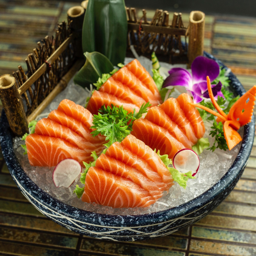

In [ ]:
# this is to test the image result.
img = ddg_images("Sake sashimi", max_results=1)
print(len(img))
print(L(img).itemgot("image"))

urls = L(img).itemgot("image")
dest = Path()
fpath = download_url(urls[0], dest, show_progress = False)
fpath

download_images('./test', urls=urls)
im = Image.open(fpath).to_thumb(256,512)
im

Aight, I think I now know how I can use these libraries. So I am going to define a function that search and donwload of images that I am interested in.

In [ ]:
def getImages(keywords, maxrResults):
    print(f"searching for {keywords} and searching for {maxrResults} of images")
    results = L(ddg_images(keywords, max_results=maxrResults)).itemgot("image") 
    print(f"search result is {len(results)}")
    return results # return image urls. 

In [ ]:
dest = Path("sashimi")

Let's double confirm the method I define works as I expect.

In [ ]:
# test
keywords = ["test-Katsuo-BonitoOrSkipjackTuna", "test-Sake-Salmon"]
dest = Path("sashimi")
dest.mkdir(exist_ok=True)

for keyword in keywords:
  urls = getImages(f"{keyword} sashimi", 1)
  destination = f"./{dest}/{keyword}"
  download_images(destination, urls=urls)

searching for test-Katsuo-BonitoOrSkipjackTuna sashimi and searching for 1 of images
search result is 1
searching for test-Sake-Salmon sashimi and searching for 1 of images
search result is 1


As I don't need these files, I am goign to remove the fodler iwth files.

In [ ]:
import shutil

# this is to remove the test folder with images. 
shutil.rmtree('./sashimi/test-Katsuo-BonitoOrSkipjackTuna')
shutil.rmtree('./sashimi/test-Sake-Salmon')

In [ ]:
import shutil

# the below code is to remove folders after existing ones failed.
# shutil.rmtree('./sashimi//Maguro-BluefinTuna')
# shutil.rmtree('./sashimi/Ahi-YellowfinAndBigeyeTuna')
# shutil.rmtree('./sashimi/Hotate-Scallops')
# shutil.rmtree('./sashimi/Ebi-SweetShrimpOrPrawns')
# shutil.rmtree('./sashimi/Ika-Squid')
# shutil.rmtree('./sashimi/Saba-JapaneseMackerel')
# shutil.rmtree('./sashimi/Hamachi-Yellowtail')
# shutil.rmtree('./sashimi/Hamadai-RedSnapper')
# shutil.rmtree('./sashimi/Katsuo-BonitoOrSkipjackTuna')
# shutil.rmtree('./sashimi/Sake-Salmon')

Okay now actually collect the data that I am interested in. 
I got the list of sashimi categories from here: https://gurunavi.com/en/japanfoodie/2016/10/sashimi-in-japan.html?__ngt__=TT141c34109003ac1e4ae226vf9ZoIGFhzmg_tnIusEce8

In [ ]:
keywords = ["Katsuo-BonitoOrSkipjackTuna", "Sake-Salmon", "Maguro-BluefinTuna", "Ahi-YellowfinAndBigeyeTuna", "Hotate-Scallops", "Ebi-SweetShrimpOrPrawns", 
            "Ika-Squid", "Saba-JapaneseMackerel", "Hamachi-Yellowtail", "Hamadai-RedSnapper"]
dest.mkdir(exist_ok=True)

for keyword in keywords:
  urls = getImages(f"{keyword} sashimi", 100)
  destination = f"./{dest}/{keyword}"
  download_images(destination, urls=urls)

searching for Katsuo-BonitoOrSkipjackTuna sashimi and searching for 100 of images
search result is 100
searching for Sake-Salmon sashimi and searching for 100 of images
search result is 100
searching for Maguro-BluefinTuna sashimi and searching for 100 of images
search result is 100
searching for Ahi-YellowfinAndBigeyeTuna sashimi and searching for 100 of images
search result is 100
searching for Hotate-Scallops sashimi and searching for 100 of images
search result is 100
searching for Ebi-SweetShrimpOrPrawns sashimi and searching for 100 of images
search result is 100
searching for Ika-Squid sashimi and searching for 100 of images
search result is 100
searching for Saba-JapaneseMackerel sashimi and searching for 100 of images
search result is 100
searching for Hamachi-Yellowtail sashimi and searching for 100 of images
search result is 100
searching for Hamadai-RedSnapper sashimi and searching for 100 of images
search result is 100


After I download all images that I need, I also need to check whether there are files that are not openable. 

It is because when we are training the model with these images, if images are not openable, the code will throw an error. 

In [ ]:
fns = get_image_files(dest)
failed = verify_images(fns)
len(failed)

23

And let's remove those unopenable images. 

In [ ]:
failed.map(Path.unlink);

To train a model with my data with Fastai, I need to create a datablock and data loaders using the images that I just downloaded.

The arguments you see in `DataBlock` is to augment the data so that the model can learn the general features of each image.


In [ ]:
from torch.utils.data import dataloader

# create a dataloader via datablock
dls = DataBlock(blocks = (ImageBlock, CategoryBlock),
  get_items = get_image_files,
  get_y     = parent_label, 
  item_tfms = RandomResizedCrop(128, min_scale=0.5), 
  batch_tfms= aug_transforms(),
  splitter = RandomSplitter(valid_pct=0.2, seed=42), 
).dataloaders(dest, bs=16)

After creating the dataloaders, let's check the dataloader for the validation set. 

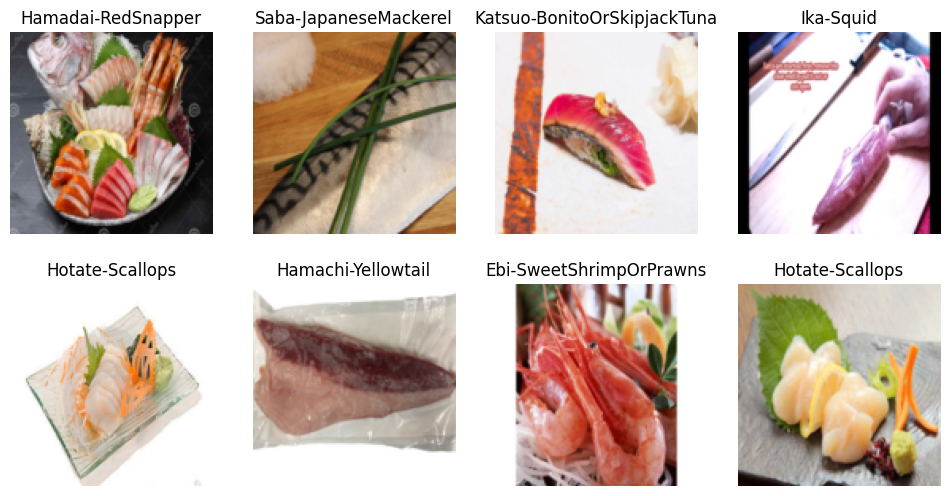

In [ ]:
dls.valid.show_batch(max_n=8)

In [ ]:
#now with the loader we are going to create a leanrer. 
# learn = vision_learner(dls, resnet34, metrics=error_rate)
# learn.fine_tune(4)

Now I have dataloaders, I can now create a learner object (specifically vision_learner, which is for images dataset). This learner object is an important concept in fastAI as this object brings together the data, the model, the loss function or metrics and the optimization algorithm to perform training on a given task. 

For the model & the metrics, I am going to use the ones the class has been using by default, resnet18 & error_rate.

I am going to experiment different models later. 

In [ ]:
#now with the loader we are going to create a leanrer. 
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(5)

epoch,train_loss,valid_loss,error_rate,time
0,3.324840,2.205537,0.654255,01:17


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,time
0,2.288811,2.022134,0.590426,01:34
1,2.031804,1.881144,0.526596,01:34
2,1.732019,1.894747,0.542553,01:35
3,1.488209,1.803150,0.505319,01:33


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,time
0,2.288811,2.022134,0.590426,01:34
1,2.031804,1.881144,0.526596,01:34
2,1.732019,1.894747,0.542553,01:35
3,1.488209,1.803150,0.505319,01:33
4,1.236431,1.803252,0.505319,01:35


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


As you can see, the error_rate is pretty high (when I ran it, it was about 5.1%). Let's analyze the data and see whether we can improve the quality of the data. 

Let's first see how the model classifies the images via the confusion matrix.

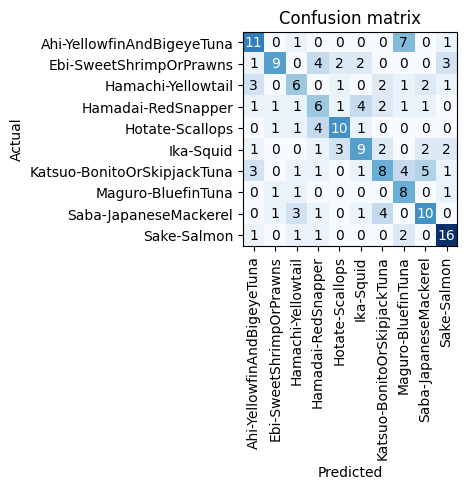

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

Let's see what are the top five losses of the model.

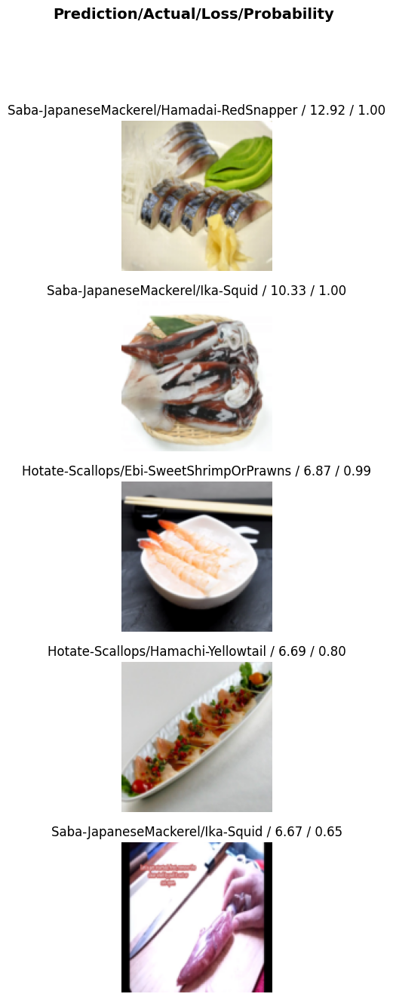

In [ ]:
interp.plot_top_losses(5, nrows=5)

I now have a sense what data that my model was confused about. I am going to clean up some images that are not necessarily helpful for the model to learn the features. 

How I am going to clean the data? 
First of all, create ImageClassifierCleaner which can shows a set of images in both training and validation data set. 

While I was looking through the images in both data sets, I found out some interesting patterns with incrorect sashmi data. 
1. An image of sashimi set. 
2. An image of fish itself
3. An image of sashimi with too much garnish or sauche. (below screenshot) 

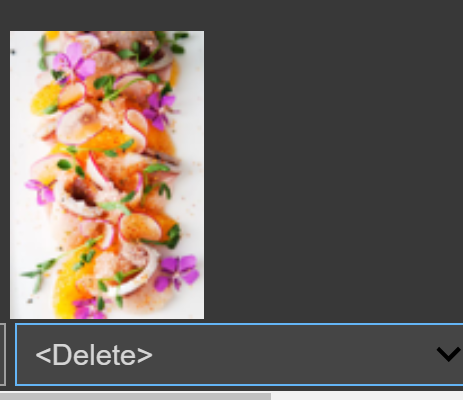


I removed images that fit into one of these three categories. 

In [ ]:
from fastai.vision.widgets import ImageClassifierCleaner
cleaner = ImageClassifierCleaner(learn)
cleaner

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), 'sashimi'/cat)

Let's train the model one more time with the cleaner data.

In [ ]:
dls = DataBlock(blocks = (ImageBlock, CategoryBlock),
  get_items = get_image_files,
  get_y     = parent_label, 
  item_tfms = RandomResizedCrop(128, min_scale=0.5), 
  batch_tfms= aug_transforms(),
  splitter = RandomSplitter(valid_pct=0.2, seed=42), 
).dataloaders(dest, bs=16)

In [ ]:
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(5)

Hmm interesting. Even though I cleaned up the data, it seems like my result isn't improved much. This time, let's try to use different models. 


In [ ]:
timm.list_models("convnext*")

['convnext_atto',
 'convnext_atto_ols',
 'convnext_base',
 'convnext_base_384_in22ft1k',
 'convnext_base_in22ft1k',
 'convnext_base_in22k',
 'convnext_femto',
 'convnext_femto_ols',
 'convnext_large',
 'convnext_large_384_in22ft1k',
 'convnext_large_in22ft1k',
 'convnext_large_in22k',
 'convnext_nano',
 'convnext_nano_ols',
 'convnext_pico',
 'convnext_pico_ols',
 'convnext_small',
 'convnext_small_384_in22ft1k',
 'convnext_small_in22ft1k',
 'convnext_small_in22k',
 'convnext_tiny',
 'convnext_tiny_384_in22ft1k',
 'convnext_tiny_hnf',
 'convnext_tiny_in22ft1k',
 'convnext_tiny_in22k',
 'convnext_xlarge_384_in22ft1k',
 'convnext_xlarge_in22ft1k',
 'convnext_xlarge_in22k']

In [ ]:
learn = vision_learner(dls, 'convnext_tiny_in22k', metrics=error_rate)
learn.fine_tune(5)

Downloading: "https://dl.fbaipublicfiles.com/convnext/convnext_tiny_22k_224.pth" to /root/.cache/torch/hub/checkpoints/convnext_tiny_22k_224.pth


epoch,train_loss,valid_loss,error_rate,time
0,2.878033,1.578722,0.500000,02:30


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,time
0,1.497452,1.311541,0.430851,03:49
1,1.361274,1.323838,0.382979,03:45
2,1.108517,1.280619,0.409574,03:42


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,time
0,1.497452,1.311541,0.430851,03:49
1,1.361274,1.323838,0.382979,03:45
2,1.108517,1.280619,0.409574,03:42
3,0.911072,1.266845,0.361702,03:40
4,0.768093,1.233585,0.382979,03:36


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Woohoo! It is actually really better! I think now I have another tool to play around with :)

Now as I am satisfied with the result, let's export the model. 

In [ ]:
learn.export('sashimiModel.pkl')